In [ ]:
from google.colab import drive
drive.mount("/content/drive")


Mounted at /content/drive


In [ ]:
!pip install -q segment-anything opencv-python matplotlib torch torchvision


In [ ]:
!wget -q https://dl.fbaipublicfiles.com/segment_anything/sam_vit_b_01ec64.pth


^C


In [ ]:
device = "cuda" if torch.cuda.is_available() else "cpu"

sam = sam_model_registry["vit_b"](
    checkpoint="/content/sam_vit_b_01ec64.pth"
)
sam.to(device)

predictor = SamPredictor(sam)


In [ ]:
def resize_for_sam(image, max_side=512):
    h, w = image.shape[:2]
    scale = max_side / max(h, w)

    if scale < 1:
        image = cv2.resize(
            image,
            (int(w * scale), int(h * scale)),
            interpolation=cv2.INTER_AREA
        )
    else:
        scale = 1.0

    return image, scale


In [ ]:
def order_corners(pts):
    pts = np.array(pts)
    s = pts.sum(axis=1)
    diff = np.diff(pts, axis=1)

    tl = pts[np.argmin(s)]
    br = pts[np.argmax(s)]
    tr = pts[np.argmin(diff)]
    bl = pts[np.argmax(diff)]

    return np.array([tl, tr, br, bl])


In [ ]:
def rectangularity(cnt):
    area = cv2.contourArea(cnt)
    x, y, w, h = cv2.boundingRect(cnt)
    return area / (w * h + 1e-6)

def solidity(cnt):
    area = cv2.contourArea(cnt)
    hull_area = cv2.contourArea(cv2.convexHull(cnt))
    return area / (hull_area + 1e-6)

def edge_straightness(corners):
    edges = [
        np.linalg.norm(corners[1] - corners[0]),
        np.linalg.norm(corners[2] - corners[1]),
        np.linalg.norm(corners[3] - corners[2]),
        np.linalg.norm(corners[0] - corners[3])
    ]
    return min(edges) / max(edges)


In [ ]:
def is_a4_contour(cnt, img_area, tol=0.20):
    area = cv2.contourArea(cnt)
    if area < 0.08 * img_area:
        return False, None

    cnt = cv2.convexHull(cnt)
    peri = cv2.arcLength(cnt, True)
    approx = cv2.approxPolyDP(cnt, 0.04 * peri, True)

    if len(approx) != 4:
        return False, None

    corners = order_corners(approx.reshape(4, 2))

    w = np.linalg.norm(corners[1] - corners[0])
    h = np.linalg.norm(corners[3] - corners[0])
    if w < 40 or h < 40:
        return False, None

    ratio = max(w, h) / min(w, h)
    if abs(ratio - np.sqrt(2)) > tol:
        return False, None

    rect = rectangularity(cnt)
    if rect < 0.80 or rect > 0.98:
        return False, None

    if solidity(cnt) < 0.90:
        return False, None

    if edge_straightness(corners) < 0.65:
        return False, None

    return True, corners


In [ ]:
def detect_a4_with_sam(image_bgr):
    image_rgb = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2RGB)
    image_small, scale = resize_for_sam(image_rgb)

    predictor.set_image(image_small)
    h, w, _ = image_small.shape
    img_area = h * w

    box = np.array([0.05*w, 0.05*h, 0.95*w, 0.95*h])
    points = np.array([
        [0.3*w, 0.3*h],
        [0.7*w, 0.3*h],
        [0.7*w, 0.7*h],
        [0.3*w, 0.7*h]
    ])
    labels = np.ones(len(points))

    masks, scores, _ = predictor.predict(
        point_coords=points,
        point_labels=labels,
        box=box,
        multimask_output=True
    )

    best_score = -1
    best_corners = None

    for mask, sam_score in zip(masks, scores):
        mask = mask.astype(np.uint8)
        cnts, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
        if not cnts:
            continue

        cnt = max(cnts, key=cv2.contourArea)
        ok, corners = is_a4_contour(cnt, img_area)

        if ok:
            area_ratio = cv2.contourArea(cnt) / img_area
            final_score = (
                0.30 * sam_score +
                0.25 * rectangularity(cnt) +
                0.15 * solidity(cnt) +
                0.30 * area_ratio
            )

            if final_score > best_score:
                best_score = final_score
                best_corners = corners

    if best_corners is None:
        return None

    corners = best_corners / scale
    return np.array(corners, dtype=np.int32)


In [ ]:
DATASET_DIR = "/content/drive/MyDrive/shoe_dataset/Dataset"

image_files = sorted([
    f for f in os.listdir(DATASET_DIR)
    if f.lower().endswith((".jpg", ".jpeg", ".png"))
])


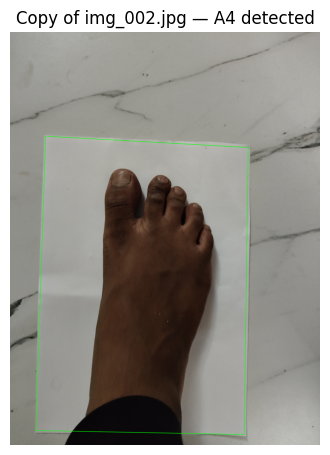

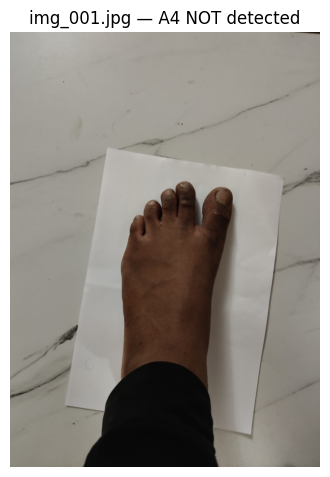

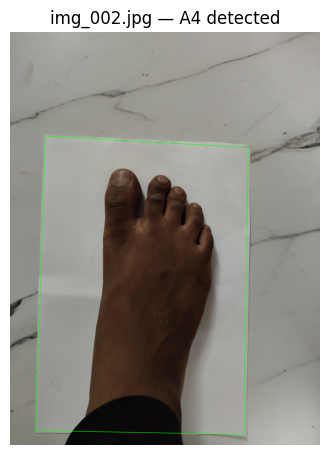

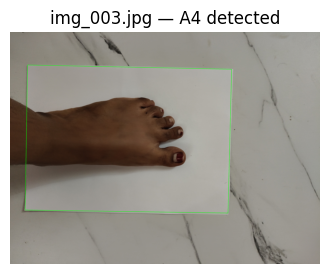

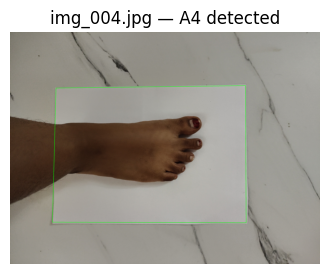

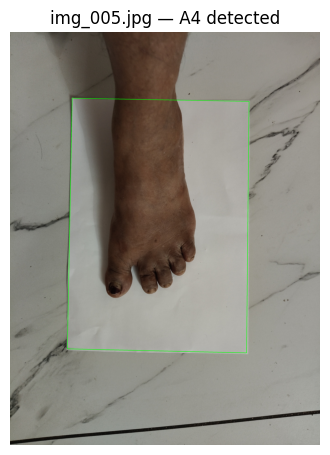

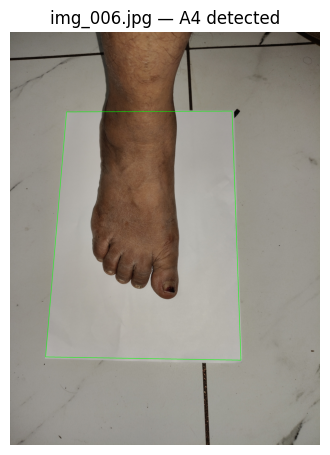

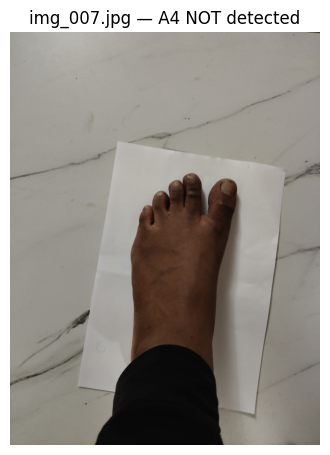

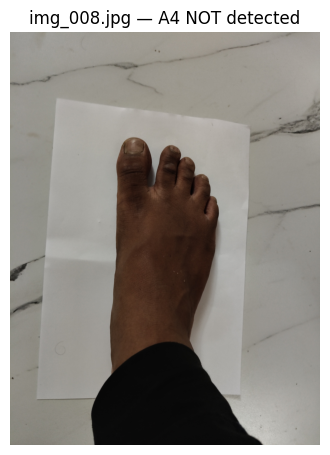

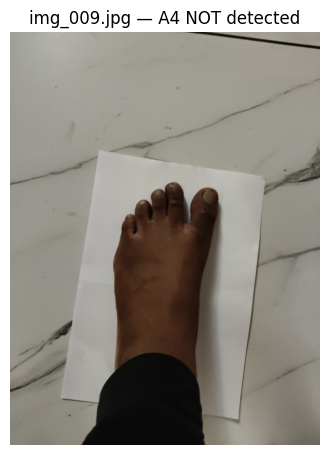

In [ ]:
for fname in image_files[:10]:
    img_path = os.path.join(DATASET_DIR, fname)
    image = cv2.imread(img_path)

    if image is None:
        continue

    corners = detect_a4_with_sam(image)
    vis = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    if corners is not None:
        pts = corners.reshape(-1, 1, 2).astype(np.int32)
        cv2.polylines(vis, [pts], True, (0, 255, 0), 3)
        title = f"{fname} — A4 detected"
    else:
        title = f"{fname} — A4 NOT detected"

    plt.figure(figsize=(4,6))
    plt.imshow(vis)
    plt.title(title)
    plt.axis("off")
    plt.show()


In [ ]:
from math import ceil

def show_batch(images, titles, cols=4):
    rows = ceil(len(images) / cols)
    plt.figure(figsize=(cols*4, rows*5))

    for i, (img, title) in enumerate(zip(images, titles)):
        plt.subplot(rows, cols, i+1)
        plt.imshow(img)
        plt.title(title, fontsize=9)
        plt.axis("off")

    plt.tight_layout()
    plt.show()



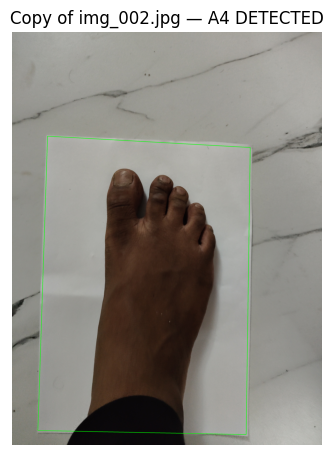

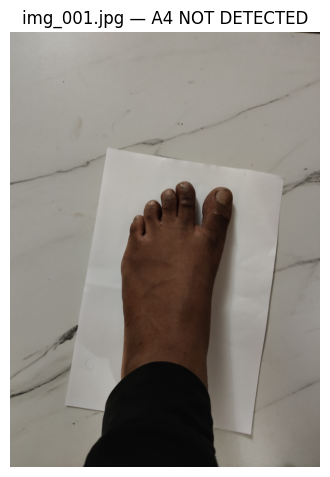

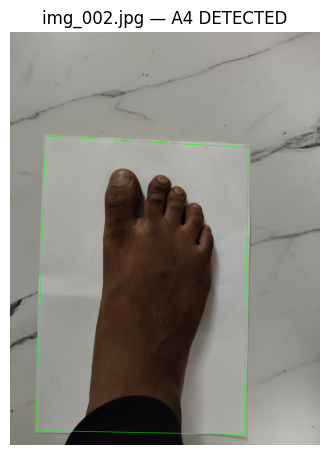

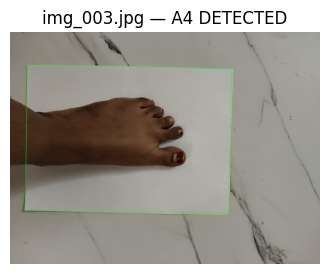

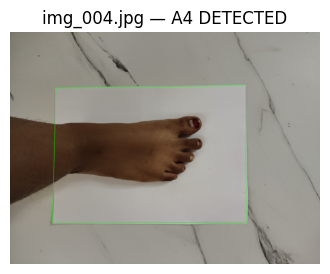

...

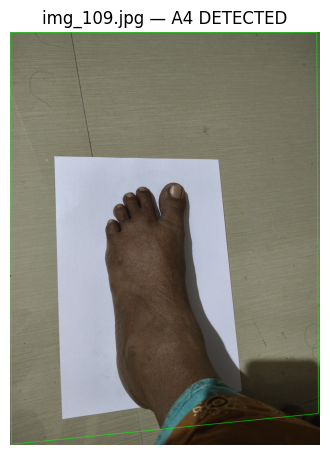

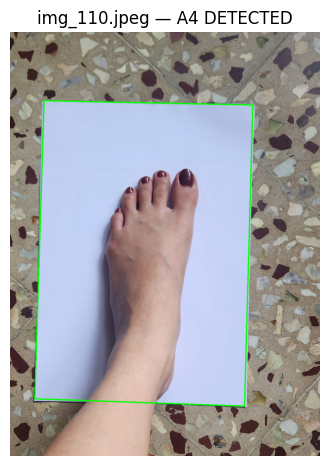

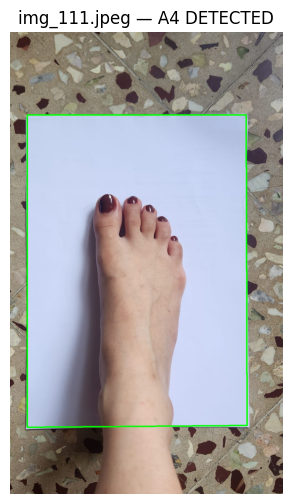

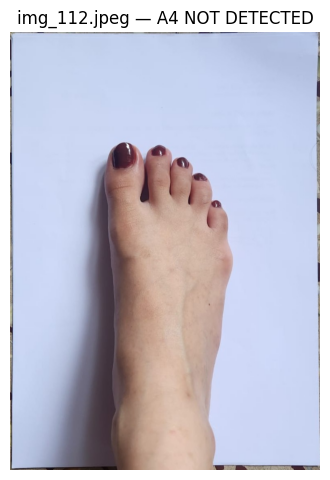

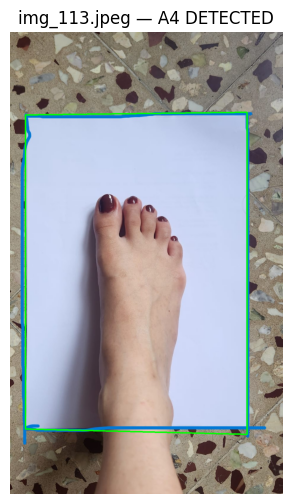

========== SUMMARY ==========
Total images       : 114
A4 detected        : 65
A4 not detected    : 49
Detection rate (%) : 57.02


In [ ]:
correct = 0
not_detected = 0
total = 0

for fname in image_files:
    img_path = os.path.join(DATASET_DIR, fname)
    image = cv2.imread(img_path)

    if image is None:
        continue

    total += 1

    corners = detect_a4_with_sam(image)
    vis = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    if corners is not None:
        pts = corners.reshape(-1, 1, 2).astype(np.int32)
        cv2.polylines(vis, [pts], True, (0, 255, 0), 3)
        title = f"{fname} — A4 DETECTED"
        correct += 1
    else:
        title = f"{fname} — A4 NOT DETECTED"
        not_detected += 1

    plt.figure(figsize=(4, 6))
    plt.imshow(vis)
    plt.title(title)
    plt.axis("off")
    plt.show()

print("========== SUMMARY ==========")
print("Total images       :", total)
print("A4 detected        :", correct)
print("A4 not detected    :", not_detected)
print("Detection rate (%) :", round((correct / total) * 100, 2))


In [ ]:
import os
import cv2
import numpy as np

DATASET_DIR = "/content/drive/MyDrive/shoe_dataset/Dataset"
IMG_SIZE = 256

def load_images():
    images = []
    names = []

    if not os.path.isdir(DATASET_DIR):
        raise FileNotFoundError(
            f"Dataset directory not found: {DATASET_DIR}"
        )

    for file in sorted(os.listdir(DATASET_DIR)):
        if file.lower().endswith((".jpg", ".png", ".jpeg")):
            path = os.path.join(DATASET_DIR, file)
            img = cv2.imread(path)

            if img is None:
                continue

            img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
            img = cv2.resize(img, (IMG_SIZE, IMG_SIZE))

            images.append(img)
            names.append(file)

    return np.array(images), names

images, image_names = load_images()

print("Loaded images:", images.shape)
print("Sample filenames:", image_names[:5])


Loaded images: (114, 256, 256, 3)
Sample filenames: ['Copy of img_002.jpg', 'img_001.jpg', 'img_002.jpg', 'img_003.jpg', 'img_004.jpg']


In [ ]:
def preprocess(img):
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    blur = cv2.GaussianBlur(gray, (5,5), 0)
    return blur

processed_images = np.array([preprocess(img) for img in images])

print("Processed shape:", processed_images.shape)


Processed shape: (114, 256, 256)


In [ ]:
def detect_a4_and_segment_foot(image_bgr):
    """
    Input : BGR image
    Output: a4_mask (uint8), a4_corners (4x2), foot_mask (uint8)
    """

    # --- Prepare image for SAM ---
    image_rgb = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2RGB)
    predictor.set_image(image_rgb)

    h, w, _ = image_rgb.shape

    # --- Automatic box covering most of image ---
    box = np.array([[0.05*w, 0.05*h, 0.95*w, 0.95*h]])

    masks, scores, _ = predictor.predict(
        box=box,
        multimask_output=True
    )

    if masks is None or len(masks) == 0:
        return None, None, None

    # --- Pick largest mask as A4 ---
    best_mask = None
    best_area = 0

    for mask in masks:
        area = np.sum(mask)
        if area > best_area:
            best_area = area
            best_mask = mask

    if best_mask is None:
        return None, None, None

    a4_mask = (best_mask.astype(np.uint8)) * 255

    # --- Extract A4 corners ---
    contours, _ = cv2.findContours(
        a4_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE
    )

    if not contours:
        return a4_mask, None, None

    cnt = max(contours, key=cv2.contourArea)
    peri = cv2.arcLength(cnt, True)
    approx = cv2.approxPolyDP(cnt, 0.02 * peri, True)

    if len(approx) != 4:
        return a4_mask, None, None

    pts = approx.reshape(4, 2)

    s = pts.sum(axis=1)
    diff = np.diff(pts, axis=1)

    tl = pts[np.argmin(s)]
    br = pts[np.argmax(s)]
    tr = pts[np.argmin(diff)]
    bl = pts[np.argmax(diff)]

    a4_corners = np.array([tl, tr, br, bl], dtype=np.int32)

    # --- Foot segmentation INSIDE A4 ---
    gray = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2GRAY)

    foot_mask = cv2.adaptiveThreshold(
        gray,
        255,
        cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
        cv2.THRESH_BINARY_INV,
        21,
        7
    )

    kernel = np.ones((7,7), np.uint8)
    foot_mask = cv2.morphologyEx(foot_mask, cv2.MORPH_CLOSE, kernel)

    # 🔥 Restrict foot strictly inside A4
    foot_mask = cv2.bitwise_and(foot_mask, a4_mask)

    return a4_mask, a4_corners, foot_mask


In [ ]:
def segment_foot(img):
    _, mask = cv2.threshold(img, 120, 255, cv2.THRESH_BINARY_INV)
    kernel = np.ones((5,5), np.uint8)
    mask = cv2.morphologyEx(mask, cv2.MORPH_OPEN, kernel)
    return mask

Saving img_013.jpg to img_013.jpg


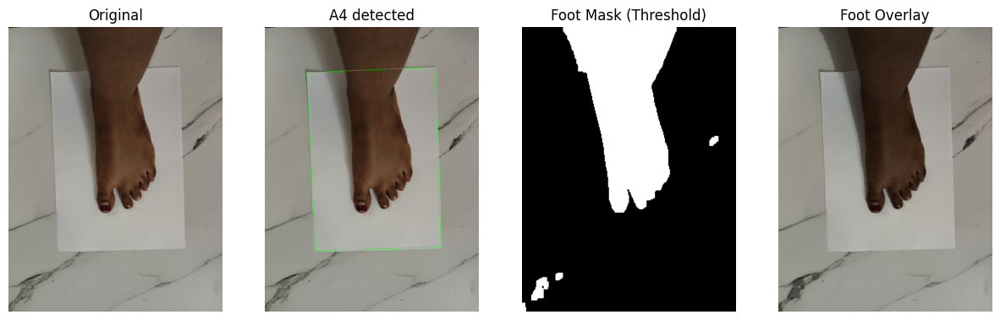

In [ ]:
from google.colab import files
import matplotlib.pyplot as plt

# -------- 1. Upload image --------
uploaded = files.upload()
img_name = list(uploaded.keys())[0]
img_path = "/content/" + img_name

image_bgr = cv2.imread(img_path)
image_rgb = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2RGB)

# -------- 2. A4 detection using SAM (reuse your function) --------
# assuming you already have detect_a4_with_sam(image_bgr)

a4_corners = detect_a4_with_sam(image_bgr)

a4_vis = image_rgb.copy()
if a4_corners is not None:
    pts = a4_corners.reshape(-1, 1, 2).astype(np.int32)
    cv2.polylines(a4_vis, [pts], True, (0, 255, 0), 3)
    a4_status = "A4 detected"
else:
    a4_status = "A4 not detected"

# -------- 3. Foot segmentation using YOUR method --------
# reuse preprocess() and segment_foot()

resized = cv2.resize(image_rgb, (IMG_SIZE, IMG_SIZE))
processed = preprocess(resized)
foot_mask =  segment_foot(processed)

# resize mask back to original image size
foot_mask_full = cv2.resize(
    foot_mask,
    (image_rgb.shape[1], image_rgb.shape[0]),
    interpolation=cv2.INTER_NEAREST
)

overlay = image_rgb.copy()
overlay[foot_mask_full == 255] = (
    0.7 * overlay[foot_mask_full == 255] + np.array([255, 0, 0])
).astype(np.uint8)

# -------- 4. Display results --------
plt.figure(figsize=(15,5))

plt.subplot(1,4,1)
plt.imshow(image_rgb)
plt.title("Original")
plt.axis("off")

plt.subplot(1,4,2)
plt.imshow(a4_vis)
plt.title(a4_status)
plt.axis("off")

plt.subplot(1,4,3)
plt.imshow(foot_mask_full, cmap="gray")
plt.title("Foot Mask (Threshold)")
plt.axis("off")

plt.subplot(1,4,4)
plt.imshow(overlay)
plt.title("Foot Overlay")
plt.axis("off")

plt.show()


In [ ]:
def measure_a4_pixels(corners):
    width_px = np.linalg.norm(corners[1] - corners[0])
    height_px = np.linalg.norm(corners[3] - corners[0])
    return width_px, height_px


In [ ]:
def extract_foot_only_mask(mask):
    """
    Robust leg removal using vertical density + heel detection.
    Assumes foot is at bottom of image.
    """
    mask = mask.copy()

    ys, xs = np.where(mask == 255)
    if len(ys) == 0:
        return None

    h = mask.shape[0]

    # --- Step 1: vertical density profile ---
    density = np.sum(mask == 255, axis=1)

    # smooth density
    density = cv2.GaussianBlur(
        density.astype(np.float32),
        (51, 1),
        0
    ).flatten()

    # --- Step 2: heel is where density is maximum ---
    heel_row = np.argmax(density)

    # --- Step 3: ankle is some distance above heel ---
    # empirical but stable
    ankle_row = int(heel_row - 0.25 * (h - heel_row))

    ankle_row = max(0, ankle_row)

    # --- Step 4: remove everything above ankle ---
    mask[:ankle_row, :] = 0

    return mask


In [ ]:
def measure_foot_pixels(mask):
    ys, xs = np.where(mask == 255)
    if len(ys) == 0:
        return None

    foot_length_px = ys.max() - ys.min()
    foot_width_px = xs.max() - xs.min()

    return foot_length_px, foot_width_px



In [ ]:
def pixels_to_mm(foot_px, a4_px):
    A4_HEIGHT_MM = 297.0
    mm_per_pixel = A4_HEIGHT_MM / a4_px
    return foot_px * mm_per_pixel


In [ ]:

def foot_mm_to_eu(mm):
    return round((mm + 15) / 6.67)


In [ ]:
def foot_mm_to_us(mm):
    return round((mm / 25.4) * 3 - 24)



In [ ]:
def foot_mm_to_uk(mm):
    return round((mm / 25.4) * 3 - 25)


In [ ]:
def calculate_shoe_size(a4_corners, foot_mask):
    # --- A4 ---
    _, a4_height_px = measure_a4_pixels(a4_corners)
    # remove leg
    foot_only_mask = extract_foot_only_mask(foot_mask_full)
    # --- Foot ---
    foot_px, foot_width_px = measure_foot_pixels(foot_mask)

    # --- Convert ---
    foot_mm = pixels_to_mm(foot_px, a4_height_px)

    return {
        "foot_length_px": foot_px,
        "foot_length_mm": round(foot_mm, 1),
        "EU_size": foot_mm_to_eu(foot_mm),
        "UK_size": foot_mm_to_uk(foot_mm),
        "US_size": foot_mm_to_us(foot_mm)
    }


In [ ]:
if a4_corners is not None and foot_mask_full is not None:
    result = calculate_shoe_size(a4_corners, foot_mask_full)

    print("Foot length (px):", result["foot_length_px"])
    print("Foot length (mm):", result["foot_length_mm"])
    print("EU size:", result["EU_size"])
    print("UK size:", result["UK_size"])
    print("US size:", result["US_size"])
else:
    print("A4 or foot not detected — cannot measure")


Foot length (px): 4095
Foot length (mm): 474.5
EU size: 73
UK size: 31
US size: 32


Foot length (cm): 24.14


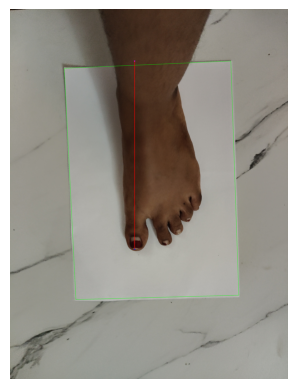

In [ ]:
import cv2
import numpy as np

def measure_foot_correct(image_bgr, a4_corners):
    """
    FINAL CORRECT FOOT MEASUREMENT
    ------------------------------
    Measure vertical distance from:
    A4 TOP EDGE  --->  TOE BOTTOM
    """

    # =============================
    # 1. A4 SCALE
    # =============================
    # A4 real height = 297 mm
    a4_height_px = np.linalg.norm(a4_corners[3] - a4_corners[0])
    mm_per_px = 297 / a4_height_px

    # A4 boundaries
    a4_x_min = int(np.min(a4_corners[:, 0]))
    a4_x_max = int(np.max(a4_corners[:, 0]))
    a4_top_y = int(np.min(a4_corners[:, 1]))
    a4_bottom_y = int(np.max(a4_corners[:, 1]))

    # =============================
    # 2. FOOT SEGMENTATION
    # =============================
    image_rgb = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2RGB)
    gray = cv2.cvtColor(image_rgb, cv2.COLOR_RGB2GRAY)
    blur = cv2.GaussianBlur(gray, (5, 5), 0)

    _, mask = cv2.threshold(
        blur, 120, 255, cv2.THRESH_BINARY_INV
    )

    kernel = np.ones((5, 5), np.uint8)
    mask = cv2.morphologyEx(mask, cv2.MORPH_OPEN, kernel)

    contours, _ = cv2.findContours(
        mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_NONE
    )

    if not contours:
        return None, "❌ Foot detect aayilla"

    foot = max(contours, key=cv2.contourArea)

    # =============================
    # 3. FOOT PIXELS INSIDE A4
    # =============================
    candidates = [
        p[0] for p in foot
        if a4_x_min <= p[0][0] <= a4_x_max
    ]

    if len(candidates) < 10:
        return None, "❌ Foot A4 ullil illa"

    # =============================
    # 4. TOE BOTTOM (CORRECT)
    # =============================
    # Toe bottom = maximum Y (foot pointing DOWN)
    ys = np.array([p[1] for p in candidates])

    # Take bottom 2% pixels (toe tip cluster)
    k = max(5, int(0.02 * len(ys)))
    toe_y = int(np.mean(np.sort(ys)[-k:]))

    # Clamp toe inside A4
    toe_y = min(toe_y, a4_bottom_y)

    # =============================
    # 5. FOOT CENTER X
    # =============================
    foot_center_x = int(np.mean([p[0] for p in candidates]))

    toe = np.array([foot_center_x, toe_y])
    a4_top_point = np.array([foot_center_x, a4_top_y])

    # =============================
    # 6. FOOT LENGTH (A4 TOP → TOE)
    # =============================
    dist_px = abs(toe_y - a4_top_y)
    foot_cm = (dist_px * mm_per_px) / 10

    # =============================
    # 7. VISUALIZATION
    # =============================
    vis = image_rgb.copy()

    # Draw A4
    cv2.polylines(
        vis, [a4_corners.astype(int)], True, (0, 255, 0), 2
    )

    # Draw measurement line
    cv2.line(vis, tuple(a4_top_point), tuple(toe), (255, 0, 0), 3)
    cv2.circle(vis, tuple(a4_top_point), 6, (255, 0, 255), -1)
    cv2.circle(vis, tuple(toe), 6, (0, 0, 255), -1)

    return vis, round(foot_cm, 2)
vis, foot_cm = measure_foot_correct(image_bgr, a4_corners)

if vis is None:
    print(foot_cm)
else:
    print("Foot length (cm):", foot_cm)
    plt.imshow(vis)
    plt.axis("off")
    plt.show()



In [ ]:
SIZE_CHART = [
    {"cm": 22.0, "EU": 35,   "UK": 3,   "US": 4},
    {"cm": 22.5, "EU": 36,   "UK": 3.5, "US": 4.5},
    {"cm": 23.0, "EU": 37,   "UK": 4,   "US": 5},
    {"cm": 23.5, "EU": 38,   "UK": 5,   "US": 6},
    {"cm": 24.0, "EU": 39,   "UK": 5.5, "US": 6.5},
    {"cm": 24.5, "EU": 40,   "UK": 6,   "US": 7},
    {"cm": 25.0, "EU": 41,   "UK": 6.5, "US": 7.5},
    {"cm": 25.5, "EU": 42,   "UK": 7,   "US": 8},
    {"cm": 26.0, "EU": 43,   "UK": 8,   "US": 9},
    {"cm": 26.5, "EU": 44,   "UK": 8.5, "US": 9.5},
    {"cm": 27.0, "EU": 45,   "UK": 9,   "US": 10},
    {"cm": 27.5, "EU": 46,   "UK": 10,  "US": 11},
]


In [ ]:
def foot_cm_to_sizes(foot_cm):
    """
    Convert foot length (cm) to EU / UK / US sizes
    """
    closest = min(
        SIZE_CHART,
        key=lambda x: abs(x["cm"] - foot_cm)
    )

    return {
        "Foot_cm": foot_cm,
        "EU": closest["EU"],
        "UK": closest["UK"],
        "US": closest["US"]
    }


In [ ]:
sizes = foot_cm_to_sizes(foot_cm)

print("Foot length (cm):", sizes["Foot_cm"])
print("EU size:", sizes["EU"])
print("UK size:", sizes["UK"])
print("US size:", sizes["US"])


Foot length (cm): 24.14
EU size: 39
UK size: 5.5
US size: 6.5


Foot length (cm): 35.26
EU: 45 UK: 9 US: 10


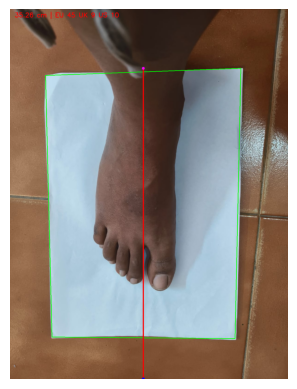

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# =====================================================
# 1. SIZE CONVERSION TABLE
# =====================================================
SIZE_CHART = [
    {"cm": 22.0, "EU": 35, "UK": 3,   "US": 4},
    {"cm": 22.5, "EU": 36, "UK": 3.5, "US": 4.5},
    {"cm": 23.0, "EU": 37, "UK": 4,   "US": 5},
    {"cm": 23.5, "EU": 38, "UK": 5,   "US": 6},
    {"cm": 24.0, "EU": 39, "UK": 5.5, "US": 6.5},
    {"cm": 24.5, "EU": 40, "UK": 6,   "US": 7},
    {"cm": 25.0, "EU": 41, "UK": 6.5, "US": 7.5},
    {"cm": 25.5, "EU": 42, "UK": 7,   "US": 8},
    {"cm": 26.0, "EU": 43, "UK": 8,   "US": 9},
    {"cm": 26.5, "EU": 44, "UK": 8.5, "US": 9.5},
    {"cm": 27.0, "EU": 45, "UK": 9,   "US": 10},
]

def cm_to_size(cm):
    return min(SIZE_CHART, key=lambda x: abs(x["cm"] - cm))


# =====================================================
# 2. ROBUST TOE DETECTION USING PCA
# =====================================================
def get_toe_point(candidates):
    """
    Robust toe detection using principal axis.
    Works for all orientations & foot shapes.
    """
    pts = np.array(candidates, dtype=np.float32)

    mean = np.mean(pts, axis=0)
    pts_centered = pts - mean

    # PCA
    _, _, vt = np.linalg.svd(pts_centered, full_matrices=False)
    axis = vt[0]

    projections = pts_centered @ axis
    toe = pts[np.argmax(projections)]

    return toe.astype(int)


# =====================================================
# 3. MAIN MEASUREMENT FUNCTION
# =====================================================
def measure_foot_auto(image_bgr, a4_corners):
    """
    Full automatic foot measurement pipeline.
    """

    # -------------------------------
    # A4 SCALE
    # -------------------------------
    a4_height_px = np.linalg.norm(a4_corners[3] - a4_corners[0])
    mm_per_px = 297 / a4_height_px

    a4_x_min = int(np.min(a4_corners[:, 0]))
    a4_x_max = int(np.max(a4_corners[:, 0]))
    a4_top_y = int(np.min(a4_corners[:, 1]))
    a4_bottom_y = int(np.max(a4_corners[:, 1]))

    # -------------------------------
    # FOOT SEGMENTATION
    # -------------------------------
    image_rgb = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2RGB)
    gray = cv2.cvtColor(image_rgb, cv2.COLOR_RGB2GRAY)
    blur = cv2.GaussianBlur(gray, (5, 5), 0)

    _, mask = cv2.threshold(blur, 120, 255, cv2.THRESH_BINARY_INV)
    kernel = np.ones((5, 5), np.uint8)
    mask = cv2.morphologyEx(mask, cv2.MORPH_OPEN, kernel)

    contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_NONE)
    if not contours:
        return None, "Foot not detected"

    foot = max(contours, key=cv2.contourArea)

    # -------------------------------
    # FOOT POINTS INSIDE A4
    # -------------------------------
    candidates = [
        p[0] for p in foot
        if a4_x_min <= p[0][0] <= a4_x_max
    ]

    if len(candidates) < 30:
        return None, "Foot not fully on A4"

    # -------------------------------
    # TOE DETECTION (ROBUST)
    # -------------------------------
    toe = get_toe_point(candidates)

    # Decide reference edge automatically
    if abs(toe[1] - a4_top_y) < abs(toe[1] - a4_bottom_y):
        ref_y = a4_bottom_y
    else:
        ref_y = a4_top_y

    # Center x for clean visualization
    foot_center_x = int(np.mean([p[0] for p in candidates]))
    toe = np.array([foot_center_x, toe[1]])
    ref_point = np.array([foot_center_x, ref_y])

    # -------------------------------
    # FOOT LENGTH
    # -------------------------------
    dist_px = abs(toe[1] - ref_y)
    foot_cm = (dist_px * mm_per_px) / 10

    # -------------------------------
    # SIZE CONVERSION
    # -------------------------------
    size = cm_to_size(foot_cm)

    # -------------------------------
    # VISUALIZATION
    # -------------------------------
    vis = image_rgb.copy()

    cv2.polylines(vis, [a4_corners.astype(int)], True, (0, 255, 0), 2)
    cv2.line(vis, tuple(ref_point), tuple(toe), (255, 0, 0), 3)
    cv2.circle(vis, tuple(ref_point), 6, (255, 0, 255), -1)
    cv2.circle(vis, tuple(toe), 6, (0, 0, 255), -1)

    cv2.putText(
        vis,
        f"{foot_cm:.2f} cm | EU {size['EU']} UK {size['UK']} US {size['US']}",
        (20, 35),
        cv2.FONT_HERSHEY_SIMPLEX,
        0.9,
        (255, 0, 0),
        2
    )

    return vis, {
        "foot_cm": round(foot_cm, 2),
        "EU": size["EU"],
        "UK": size["UK"],
        "US": size["US"]
    }


# =====================================================
# 4. USAGE
# =====================================================
vis, result = measure_foot_auto(image_bgr, a4_corners)

if vis is None:
    print(result)
else:
    print("Foot length (cm):", result["foot_cm"])
    print("EU:", result["EU"], "UK:", result["UK"], "US:", result["US"])
    plt.imshow(vis)
    plt.axis("off")
    plt.show()


In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# =====================================================
# MAIN FUNCTION
# =====================================================
def measure_foot_top_to_toe(image_bgr, a4_corners):
    """
    FULL PIPELINE:
    - Clean noisy mask
    - Recognise foot shape
    - Remove leg
    - Detect toe bottom correctly
    - Measure A4 TOP -> TOE
    """

    # -----------------------------
    # A4 SCALE
    # -----------------------------
    a4_height_px = np.linalg.norm(a4_corners[3] - a4_corners[0])
    mm_per_px = 297 / a4_height_px

    a4_top_y = int(np.min(a4_corners[:, 1]))
    a4_x_min = int(np.min(a4_corners[:, 0]))
    a4_x_max = int(np.max(a4_corners[:, 0]))

    # -----------------------------
    # INITIAL MASK (NO ASSUMPTION)
    # -----------------------------
    gray = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2GRAY)
    blur = cv2.GaussianBlur(gray, (5,5), 0)
    _, raw_mask = cv2.threshold(
        blur, 120, 255, cv2.THRESH_BINARY_INV
    )

    # -----------------------------
    # CLEAN MASK — FOOT SHAPE ONLY
    # -----------------------------
    num_labels, labels, stats, _ = cv2.connectedComponentsWithStats(
        raw_mask, connectivity=8
    )

    h, w = raw_mask.shape
    img_area = h * w

    best_label = None
    best_score = 0

    for i in range(1, num_labels):
        area = stats[i, cv2.CC_STAT_AREA]
        if area < 0.02 * img_area:
            continue

        x, y, bw, bh, _ = stats[i]
        aspect = bh / (bw + 1e-6)

        if aspect < 1.2 or aspect > 4.5:
            continue

        score = area / aspect
        if score > best_score:
            best_score = score
            best_label = i

    if best_label is None:
        return None, "❌ Foot not found"

    foot_mask = (labels == best_label).astype(np.uint8) * 255

    # -----------------------------
    # REMOVE LEG (TOP PART)
    # -----------------------------
    ys, xs = np.where(foot_mask > 0)
    y_min, y_max = ys.min(), ys.max()
    height = y_max - y_min

    cut_y = y_min + int(0.25 * height)
    foot_mask[:cut_y, :] = 0

    # -----------------------------
    # FINAL FOOT CONTOUR
    # -----------------------------
    contours, _ = cv2.findContours(
        foot_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_NONE
    )

    if not contours:
        return None, "❌ Foot contour missing"

    foot = max(contours, key=cv2.contourArea)
    pts = foot.reshape(-1, 2)

    # Keep only points inside A4 width
    pts = pts[(pts[:,0] >= a4_x_min) & (pts[:,0] <= a4_x_max)]
    if len(pts) < 30:
        return None, "❌ Foot outside A4"

    # -----------------------------
    # TOE BOTTOM (WIDTH-BASED)
    # -----------------------------
    ys = pts[:,1]
    xs = pts[:,0]

    y_start = int(np.percentile(ys, 90))
    y_end = ys.min()

    toe_y = None
    max_width = 0

    for y in range(y_start, y_end, -1):
        band = pts[np.abs(ys - y) < 2]
        if len(band) < 20:
            continue

        width = band[:,0].max() - band[:,0].min()
        if width > max_width:
            max_width = width
            toe_y = y

    if toe_y is None:
        toe_y = ys.max()

    toe_x = int(np.mean(pts[np.abs(ys - toe_y) < 2][:,0]))

    # -----------------------------
    # FOOT LENGTH
    # -----------------------------
    dist_px = toe_y - a4_top_y
    foot_cm = (dist_px * mm_per_px) / 10

    # -----------------------------
    # VISUALIZATION
    # -----------------------------
    vis = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2RGB)

    cv2.polylines(vis, [a4_corners.astype(int)], True, (0,255,0), 2)
    cv2.line(vis, (toe_x, a4_top_y), (toe_x, toe_y), (255,0,0), 3)
    cv2.circle(vis, (toe_x, toe_y), 6, (0,0,255), -1)
    cv2.circle(vis, (toe_x, a4_top_y), 6, (255,0,255), -1)

    return vis, round(foot_cm, 2)


# =====================================================
# USAGE
# =====================================================
vis, foot_cm = measure_foot_top_to_toe(image_bgr, a4_corners)

print("Foot length (cm):", foot_cm)

plt.imshow(vis)
plt.axis("off")
plt.show()


NameError: name 'image_bgr' is not defined

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def measure_foot_top_to_toe_scanline(image_bgr, a4_corners):
    """
    Uses ROW-WISE CONTINUITY ONLY
    No mask cleaning
    No connected components
    No shape assumptions
    """

    # -----------------------------
    # A4 SCALE
    # -----------------------------
    a4_height_px = np.linalg.norm(a4_corners[3] - a4_corners[0])
    mm_per_px = 297 / a4_height_px

    a4_top_y = int(np.min(a4_corners[:, 1]))
    a4_x_min = int(np.min(a4_corners[:, 0]))
    a4_x_max = int(np.max(a4_corners[:, 0]))

    # -----------------------------
    # RAW MASK ONLY
    # -----------------------------
    gray = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2GRAY)
    blur = cv2.GaussianBlur(gray, (5, 5), 0)
    _, mask = cv2.threshold(
        blur, 120, 255, cv2.THRESH_BINARY_INV
    )

    h, w = mask.shape

    # -----------------------------
    # SCANLINE TOE DETECTION
    # -----------------------------
    toe_y = None
    toe_x = None

    min_continuous_width = int(0.25 * (a4_x_max - a4_x_min))
    # 👆 toe region must be at least 25% of A4 width

    previous_valid = False

    for y in range(h - 1, a4_top_y, -1):
        row = mask[y, a4_x_min:a4_x_max]

        # find longest continuous white segment
        max_run = 0
        run = 0
        xs = []

        for i, val in enumerate(row):
            if val == 255:
                run += 1
                xs.append(i)
                max_run = max(max_run, run)
            else:
                run = 0
                xs = []

        if max_run >= min_continuous_width:
            # valid foot row
            previous_valid = True
            toe_y = y
            toe_x = int(a4_x_min + np.mean(xs))
        else:
            # continuity broken AFTER foot started → stop
            if previous_valid:
                break

    if toe_y is None:
        return None, "❌ Toe not detected"

    # -----------------------------
    # FOOT LENGTH
    # -----------------------------
    dist_px = toe_y - a4_top_y
    foot_cm = (dist_px * mm_per_px) / 10

    # -----------------------------
    # VISUALIZATION
    # -----------------------------
    vis = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2RGB)

    cv2.polylines(vis, [a4_corners.astype(int)], True, (0, 255, 0), 2)
    cv2.line(vis, (toe_x, a4_top_y), (toe_x, toe_y), (255, 0, 0), 3)
    cv2.circle(vis, (toe_x, toe_y), 6, (0, 0, 255), -1)
    cv2.circle(vis, (toe_x, a4_top_y), 6, (255, 0, 255), -1)

    return vis, round(foot_cm, 2)


# -----------------------------
# USAGE
# -----------------------------
vis, foot_cm = measure_foot_top_to_toe_scanline(image_bgr, a4_corners)

print("Foot length (cm):", foot_cm)

plt.imshow(vis)
plt.axis("off")
plt.show()


NameError: name 'image_bgr' is not defined

Foot length (cm): 30.48


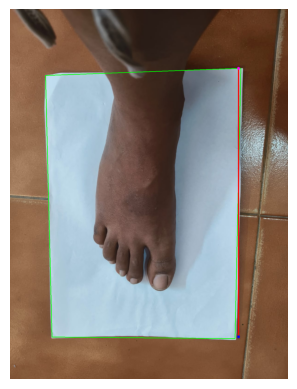

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# =====================================================
# FIND TOE USING MASK-ONLY ROW ITERATION
# =====================================================
def find_toe_from_mask(mask, a4_x_min, a4_x_max, a4_top_y):
    """
    Iterate ONLY through binary mask.
    Scan rows bottom -> top.
    Toe bottom = last row with continuous white pixels.
    """

    h, w = mask.shape

    min_width = int(0.25 * (a4_x_max - a4_x_min))  # toe must be wide
    toe_y = None
    toe_x = None
    inside_foot = False

    for y in range(h - 1, a4_top_y, -1):
        row = mask[y, a4_x_min:a4_x_max]

        max_run = 0
        run = 0
        run_positions = []

        for i, val in enumerate(row):
            if val == 255:
                run += 1
                run_positions.append(i)
                max_run = max(max_run, run)
            else:
                run = 0
                run_positions = []

        if max_run >= min_width:
            inside_foot = True
            toe_y = y
            toe_x = int(a4_x_min + np.mean(run_positions))
        else:
            if inside_foot:
                break  # foot ended

    return toe_x, toe_y


# =====================================================
# MAIN MEASUREMENT FUNCTION
# =====================================================
def measure_foot_top_to_toe_mask_only(image_bgr, a4_corners):
    """
    FULL PIPELINE:
    - Create binary mask
    - Iterate through mask rows only
    - Detect toe bottom
    - Measure A4 TOP -> TOE
    """

    # -----------------------------
    # A4 SCALE
    # -----------------------------
    a4_height_px = np.linalg.norm(a4_corners[3] - a4_corners[0])
    mm_per_px = 297 / a4_height_px

    a4_top_y = int(np.min(a4_corners[:, 1]))
    a4_x_min = int(np.min(a4_corners[:, 0]))
    a4_x_max = int(np.max(a4_corners[:, 0]))

    # -----------------------------
    # BINARY MASK (ONLY SOURCE)
    # -----------------------------
    gray = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2GRAY)
    blur = cv2.GaussianBlur(gray, (5, 5), 0)
    _, mask = cv2.threshold(blur, 120, 255, cv2.THRESH_BINARY_INV)

    # -----------------------------
    # TOE DETECTION (MASK ONLY)
    # -----------------------------
    toe_x, toe_y = find_toe_from_mask(
        mask, a4_x_min, a4_x_max, a4_top_y
    )

    if toe_y is None:
        return None, "❌ Toe not detected"

    # -----------------------------
    # FOOT LENGTH
    # -----------------------------
    dist_px = toe_y - a4_top_y
    foot_cm = (dist_px * mm_per_px) / 10

    # -----------------------------
    # VISUALIZATION (NO LOGIC)
    # -----------------------------
    vis = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2RGB)

    cv2.polylines(vis, [a4_corners.astype(int)], True, (0, 255, 0), 2)
    cv2.line(vis, (toe_x, a4_top_y), (toe_x, toe_y), (255, 0, 0), 3)
    cv2.circle(vis, (toe_x, toe_y), 6, (0, 0, 255), -1)
    cv2.circle(vis, (toe_x, a4_top_y), 6, (255, 0, 255), -1)

    return vis, round(foot_cm, 2)


# =====================================================
# USAGE
# =====================================================
vis, foot_cm = measure_foot_top_to_toe_mask_only(image_bgr, a4_corners)

print("Foot length (cm):", foot_cm)

plt.imshow(vis)
plt.axis("off")
plt.show()


Foot length (cm): 35.34


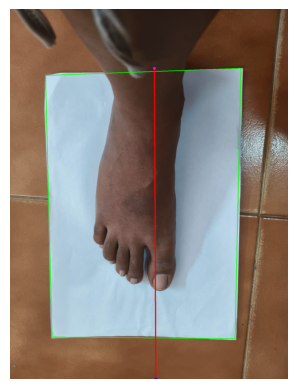

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def measure_foot_axis_mask_only(image_bgr, a4_corners):
    """
    Measure foot length by:
    - Using ONLY binary mask
    - Finding foot principal axis
    - Iterating along axis from A4 TOP
    - Stopping when continuity breaks
    """

    # --------------------------------------------------
    # A4 SCALE
    # --------------------------------------------------
    a4_height_px = np.linalg.norm(a4_corners[3] - a4_corners[0])
    mm_per_px = 297 / a4_height_px

    a4_top_y = int(np.min(a4_corners[:, 1]))

    # --------------------------------------------------
    # CREATE BINARY MASK
    # --------------------------------------------------
    gray = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2GRAY)
    blur = cv2.GaussianBlur(gray, (5, 5), 0)
    _, mask = cv2.threshold(blur, 120, 255, cv2.THRESH_BINARY_INV)

    # --------------------------------------------------
    # GET FOOT PIXELS (MASK ONLY)
    # --------------------------------------------------
    ys, xs = np.where(mask == 255)

    if len(xs) < 100:
        return None, "❌ Not enough foot pixels"

    pts = np.column_stack((xs, ys)).astype(np.float32)

    # --------------------------------------------------
    # PRINCIPAL AXIS (PCA)
    # --------------------------------------------------
    mean = np.mean(pts, axis=0)
    pts_centered = pts - mean

    _, _, vt = np.linalg.svd(pts_centered, full_matrices=False)
    axis = vt[0]  # main direction (unit vector)

    # Ensure axis points downward
    if axis[1] < 0:
        axis = -axis

    # --------------------------------------------------
    # PROJECT POINTS ON AXIS
    # --------------------------------------------------
    projections = pts_centered @ axis

    # Shift projections so A4 top is zero
    a4_top_proj = (np.array([mean[0], a4_top_y]) - mean) @ axis
    projections = projections - a4_top_proj

    # --------------------------------------------------
    # ITERATE ALONG AXIS (MASK ONLY)
    # --------------------------------------------------
    step = 1.0  # pixel resolution
    max_proj = np.max(projections)

    inside = False
    toe_proj = None

    for t in np.arange(0, max_proj, step):
        band = np.abs(projections - t) < 1.0

        if np.count_nonzero(band) > 15:
            inside = True
            toe_proj = t
        else:
            if inside:
                break

    if toe_proj is None:
        return None, "❌ Toe not detected"

    # --------------------------------------------------
    # TOE POINT (BACK TO IMAGE SPACE)
    # --------------------------------------------------
    toe_point = mean + axis * (toe_proj + a4_top_proj)
    toe_x, toe_y = toe_point.astype(int)

    # --------------------------------------------------
    # FOOT LENGTH
    # --------------------------------------------------
    dist_px = toe_proj
    foot_cm = (dist_px * mm_per_px) / 10

    # --------------------------------------------------
    # VISUALIZATION ONLY
    # --------------------------------------------------
    vis = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2RGB)

    cv2.polylines(vis, [a4_corners.astype(int)], True, (0, 255, 0), 2)
    cv2.line(
        vis,
        (int(mean[0]), a4_top_y),
        (toe_x, toe_y),
        (255, 0, 0),
        3
    )

    cv2.circle(vis, (toe_x, toe_y), 6, (0, 0, 255), -1)
    cv2.circle(vis, (int(mean[0]), a4_top_y), 6, (255, 0, 255), -1)

    return vis, round(foot_cm, 2)


# --------------------------------------------------
# USAGE
# --------------------------------------------------
vis, foot_cm = measure_foot_axis_mask_only(image_bgr, a4_corners)

print("Foot length (cm):", foot_cm)

plt.imshow(vis)
plt.axis("off")
plt.show()


In [ ]:
# =========================
# ONE-CELL FULL PIPELINE
# =========================

from google.colab import files
import cv2
import numpy as np
import matplotlib.pyplot as plt

# -------------------------
# Shoe size conversion
# -------------------------
def cm_to_sizes(cm):
    EU = round(cm * 1.5 + 1.5)
    UK = round((cm - 23) * 0.5 + 5)
    US = UK + 1
    return EU, UK, US

# -------------------------
# Upload image
# -------------------------
uploaded = files.upload()
img_path = list(uploaded.keys())[0]

image_bgr = cv2.imread(img_path)
image_rgb = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2RGB)
h, w, _ = image_rgb.shape

# -------------------------
# 1. A4 DETECTION USING SAM
# -------------------------
predictor.set_image(image_rgb)

box = np.array([[0.05*w, 0.05*h, 0.95*w, 0.95*h]])
masks, scores, _ = predictor.predict(box=box, multimask_output=True)

if masks is None or len(masks) == 0:
    raise RuntimeError("❌ SAM failed to detect A4")

# Pick largest mask as A4
a4_mask = max(masks, key=lambda m: np.sum(m))
a4_mask = (a4_mask.astype(np.uint8)) * 255

# -------------------------
# 2. A4 CORNERS + SCALE
# -------------------------
cnts, _ = cv2.findContours(a4_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
cnt = max(cnts, key=cv2.contourArea)

peri = cv2.arcLength(cnt, True)
approx = cv2.approxPolyDP(cnt, 0.02 * peri, True)

if len(approx) != 4:
    raise RuntimeError("❌ A4 corners not found")

a4_corners = approx.reshape(4,2)

# Bottom edge (heel plane)
bottom_y = a4_corners[:,1].max()

# A4 scale (use longer side)
w_px = np.linalg.norm(a4_corners[0] - a4_corners[1])
h_px = np.linalg.norm(a4_corners[1] - a4_corners[2])
a4_px = max(w_px, h_px)
mm_per_px = 297 / a4_px   # A4 long side = 297mm

# -------------------------
# 3. FOOT MASK (YOUR METHOD)
# -------------------------
gray = cv2.cvtColor(image_rgb, cv2.COLOR_RGB2GRAY)
blur = cv2.GaussianBlur(gray, (5,5), 0)

_, foot_mask = cv2.threshold(
    blur, 120, 255, cv2.THRESH_BINARY_INV
)

kernel = np.ones((5,5), np.uint8)
foot_mask = cv2.morphologyEx(foot_mask, cv2.MORPH_OPEN, kernel)

# Keep only foot above A4 bottom
foot_mask[int(bottom_y):, :] = 0

# -------------------------
# 4. FOOT CONTOUR
# -------------------------
contours, _ = cv2.findContours(
    foot_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_NONE
)

if not contours:
    raise RuntimeError("❌ Foot not detected")

foot = max(contours, key=cv2.contourArea)
pts = foot.reshape(-1,2).astype(np.float32)

# -------------------------
# 5. TOE DETECTION (FIXED)
# -------------------------
mean = pts.mean(axis=0)
_, _, vt = np.linalg.svd(pts - mean)
axis = vt[0]

# Ensure axis points upward
if axis[1] > 0:
    axis = -axis

projections = (pts - mean) @ axis

toe_proj = projections.max()
heel_proj = projections.min()

toe = mean + axis * toe_proj
heel = mean + axis * heel_proj

# -------------------------
# 6. FOOT LENGTH + SIZE
# -------------------------
foot_px = np.linalg.norm(toe - heel)
foot_cm = (foot_px * mm_per_px) / 10

EU, UK, US = cm_to_sizes(foot_cm)

# -------------------------
# 7. VISUALIZATION
# -------------------------
vis = image_rgb.copy()
cv2.polylines(vis, [a4_corners.reshape(-1,1,2)], True, (0,255,0), 3)
cv2.line(vis, tuple(heel.astype(int)), tuple(toe.astype(int)), (255,0,0), 3)

plt.figure(figsize=(14,5))

plt.subplot(1,3,1)
plt.imshow(image_rgb)
plt.title("Original")
plt.axis("off")

plt.subplot(1,3,2)
plt.imshow(foot_mask, cmap="gray")
plt.title("Foot Mask")
plt.axis("off")

plt.subplot(1,3,3)
plt.imshow(vis)
plt.title(
    f"Foot: {foot_cm:.2f} cm | EU {EU} | UK {UK} | US {US}"
)
plt.axis("off")

plt.show()

print(f"✅ Foot length: {foot_cm:.2f} cm")
print(f"EU: {EU}, UK: {UK}, US: {US}")


Saving gcf.jpeg to gcf.jpeg


RuntimeError: ❌ A4 corners not found